In [10]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import GlobalAveragePooling2D
import os
import numpy as np
import cv2
import tensorflow as tf
from sklearn.model_selection import train_test_split

In [11]:
image_dir = '/blue/cap4773/tej/Automated-Pavement-Management/data/processed/train/images'
label_dir = '/blue/cap4773/tej/Automated-Pavement-Management/data/processed/train/labels'

In [21]:
def parse_yolo_label(label_file, img_w, img_h):
    with open(label_file, 'r') as f:
        labels = []
        for line in f.readlines():
            class_id, x_center, y_center, width, height = map(float, line.strip().split())
            # Convert normalized YOLO format to (xmin, ymin, xmax, ymax)
            xmin = (x_center - width / 2) * img_w
            ymin = (y_center - height / 2) * img_h
            xmax = (x_center + width / 2) * img_w
            ymax = (y_center + height / 2) * img_h
            labels.append([class_id, xmin, ymin, xmax, ymax])
    return labels

In [13]:
def load_data(image_dir, label_dir, img_size):
    images = []
    labels = []
    for img_file in os.listdir(image_dir):
        if img_file.endswith(".jpeg"):
            img_path = os.path.join(image_dir, img_file)
            label_path = os.path.join(label_dir, img_file.replace('.jpeg', '.txt'))
            
            # Read and resize the image
            img = cv2.imread(img_path)
            img = cv2.resize(img, (img_size, img_size))
            img_h, img_w, _ = img.shape
            
            # Normalize the image
            img = img / 255.0
            images.append(img)

            # Parse the corresponding label file
            label = parse_yolo_label(label_path, img_w, img_h)
            labels.append(label)
    
    return np.array(images), labels

In [14]:
def preprocess_labels(labels, num_classes, img_size):
    bbox_targets = []
    class_targets = []
    for label in labels:
        class_ids = np.zeros((num_classes,))
        bbox = np.zeros((4,))
        
        for obj in label:
            class_id, xmin, ymin, xmax, ymax = obj
            class_ids[int(class_id)] = 1  # One-hot encoding
            bbox = [xmin / img_size, ymin / img_size, xmax / img_size, ymax / img_size]
        
        class_targets.append(class_ids)
        bbox_targets.append(bbox)
    
    return np.array(class_targets), np.array(bbox_targets)

In [15]:
img_size = 512
images, labels = load_data(image_dir, label_dir, img_size)
train_images, val_images, train_labels, val_labels = train_test_split(images, labels, test_size=0.2)

num_classes = 4  # Adjust based on your dataset
train_class_labels, train_bbox_labels = preprocess_labels(train_labels, num_classes, img_size)
val_class_labels, val_bbox_labels = preprocess_labels(val_labels, num_classes, img_size)


In [16]:
def build_multilabel_classifier_with_bbox(input_shape=(512, 512, 3), num_classes=3):
    inputs = Input(shape=input_shape)

    # First Convolutional Block
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.25)(x)

    # Second Convolutional Block
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.25)(x)

    # Third Convolutional Block
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.25)(x)

    # Fully Connected Layers
    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)

    x = Dense(64, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)

    # Classification Output: One neuron per class with sigmoid activation
    classification_output = Dense(num_classes, activation='sigmoid', name='class_output')(x)

    # Bounding Box Output: 4 values with linear activation (continuous output)
    bbox_output = Dense(4, activation='linear', name='bbox_output')(x)

    # Define the Model with two outputs
    model = Model(inputs=inputs, outputs=[classification_output, bbox_output])

    # Compile the model
    model.compile(optimizer='adam', 
                  loss={'class_output': 'binary_crossentropy', 'bbox_output': 'mse'}, 
                  metrics={'class_output': 'accuracy', 'bbox_output': 'mse'})

    return model

In [17]:
train_targets = {
    'class_output': train_class_labels,
    'bbox_output': train_bbox_labels
}

val_targets = {
    'class_output': val_class_labels,
    'bbox_output': val_bbox_labels
}

num_classes = 4
model = build_multilabel_classifier_with_bbox(input_shape=(512, 512, 3), num_classes=num_classes)


history = model.fit(train_images, train_targets, 
                    validation_data=(val_images, val_targets),
                    batch_size=16, epochs=100)

Epoch 1/100
133/133 [==============================] - 10s 61ms/step - loss: 2.8992 - class_output_loss: 0.9327 - bbox_output_loss: 1.9665 - class_output_accuracy: 0.2547 - bbox_output_mse: 1.9665 - val_loss: 10956.1582 - val_class_output_loss: 53.6428 - val_bbox_output_loss: 10902.5156 - val_class_output_accuracy: 0.2068 - val_bbox_output_mse: 10902.5156
Epoch 2/100
133/133 [==============================] - 6s 46ms/step - loss: 1.6435 - class_output_loss: 0.7699 - bbox_output_loss: 0.8736 - class_output_accuracy: 0.3154 - bbox_output_mse: 0.8736 - val_loss: 2146.3904 - val_class_output_loss: 23.3864 - val_bbox_output_loss: 2123.0039 - val_class_output_accuracy: 0.1992 - val_bbox_output_mse: 2123.0039
Epoch 3/100
133/133 [==============================] - 6s 47ms/step - loss: 1.1589 - class_output_loss: 0.7110 - bbox_output_loss: 0.4479 - class_output_accuracy: 0.3013 - bbox_output_mse: 0.4479 - val_loss: 720.0366 - val_class_output_loss: 16.0213 - val_bbox_output_loss: 704.0153 - val

In [3]:
import matplotlib.pyplot as plt
import cv2

# Function to display image with bounding boxes
def display_image_with_bbox(image, bbox, predicted_bbox=None, title=None):
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    
    # Plot original image with ground truth
    ax[0].imshow(image)
    ax[0].set_title("Ground Truth")
    # Draw ground truth bounding box
    xmin, ymin, xmax, ymax = bbox
    rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, edgecolor='green', facecolor='none', lw=2)
    ax[0].add_patch(rect)
    
    # Plot image with predicted bounding box
    ax[1].imshow(image)
    ax[1].set_title("Predicted")
    if predicted_bbox is not None:
        pxmin, pymin, pxmax, pymax = predicted_bbox
        pred_rect = plt.Rectangle((pxmin, pymin), pxmax - pxmin, pymax - pymin, edgecolor='red', facecolor='none', lw=2)
        ax[1].add_patch(pred_rect)
    
    plt.suptitle(title)
    plt.show()

In [25]:
from keras.models import load_model
model = load_model('model.h5')

In [22]:
def display_predictions(image_dir, label_dir, model, img_size=512):
    for img_file in os.listdir(image_dir):
        if img_file.endswith(".jpeg"):
            img_path = os.path.join(image_dir, img_file)
            label_path = os.path.join(label_dir, img_file.replace('.jpeg', '.txt'))
            
            # Read and preprocess the image
            img = cv2.imread(img_path)
            img_resized = cv2.resize(img, (img_size, img_size)) / 255.0
            img_h, img_w, _ = img.shape
            
            # Parse the ground truth label
            ground_truth = parse_yolo_label(label_path, img_w, img_h)[0]  # Assuming one object
            
            # Make prediction using the model
            img_input = np.expand_dims(img_resized, axis=0)
            class_pred, bbox_pred = model.predict(img_input)
            
            # Denormalize the predicted bounding box
            pxmin, pymin, pxmax, pymax = bbox_pred[0]
            pxmin = int(pxmin * img_w)
            pymin = int(pymin * img_h)
            pxmax = int(pxmax * img_w)
            pymax = int(pymax * img_h)
            predicted_bbox = [pxmin, pymin, pxmax, pymax]
            
            # Display the images with bounding boxes
            display_image_with_bbox(img, ground_truth[1:], predicted_bbox, title=f"Image: {img_file}")

In [23]:
test_image_dir = '/blue/cap4773/tej/Automated-Pavement-Management/data/processed/test/images'
test_label_dir = '/blue/cap4773/tej/Automated-Pavement-Management/data/processed/test/labels'

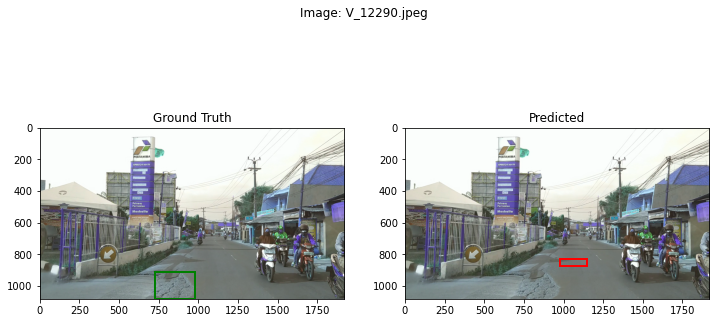

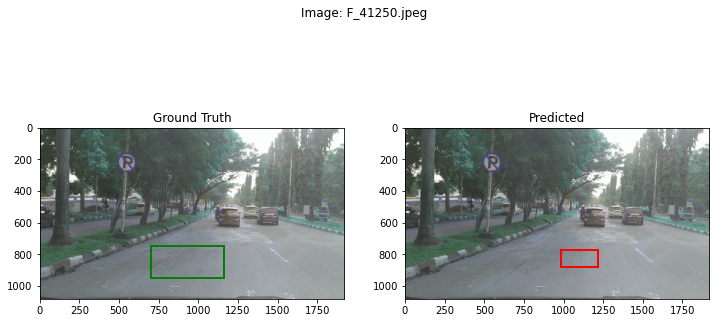

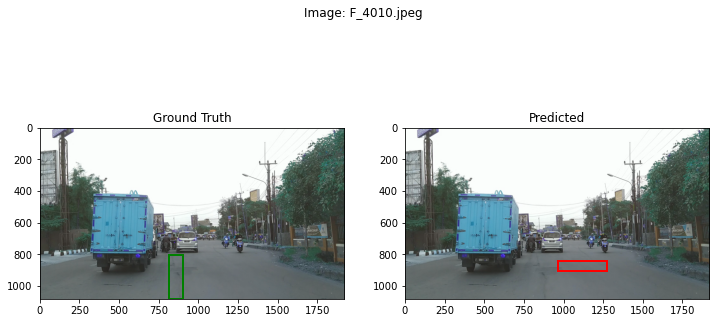

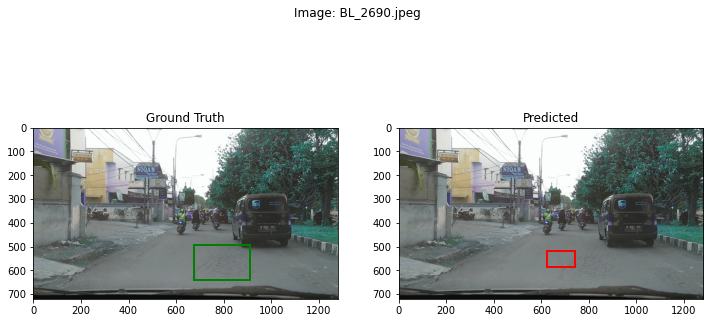

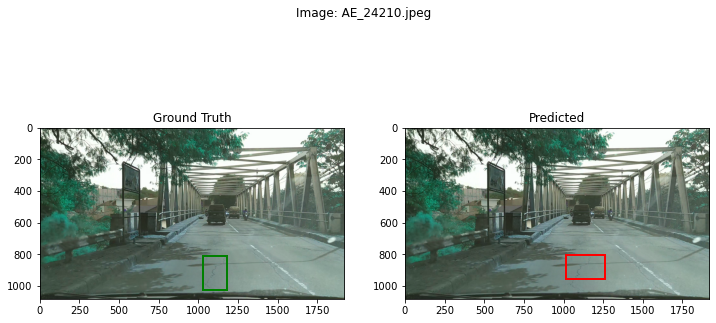

...

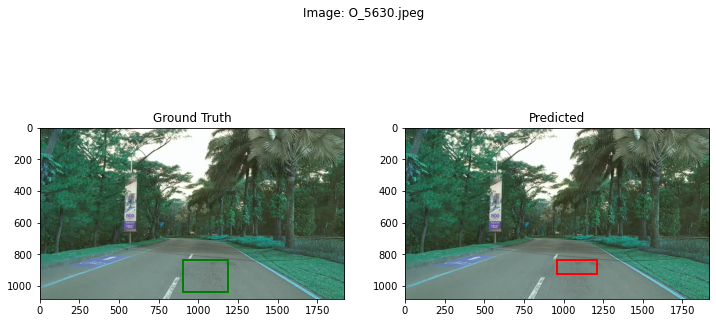

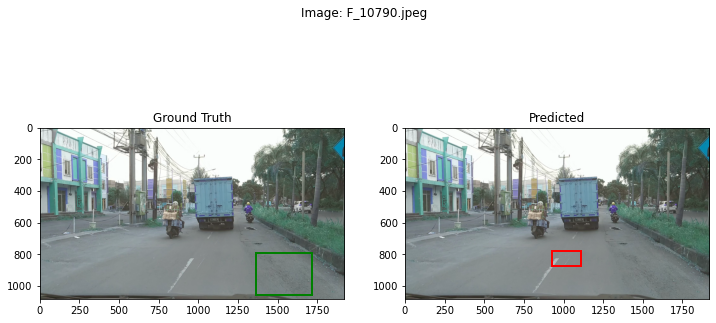

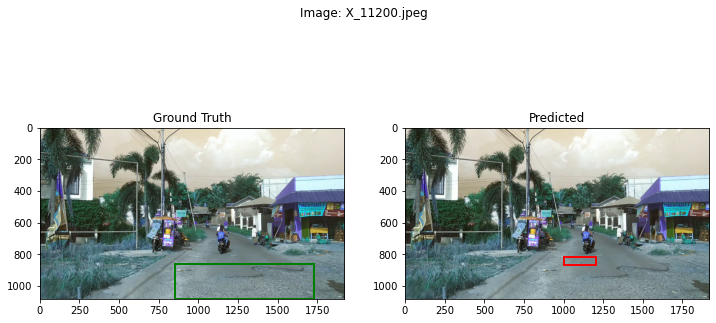

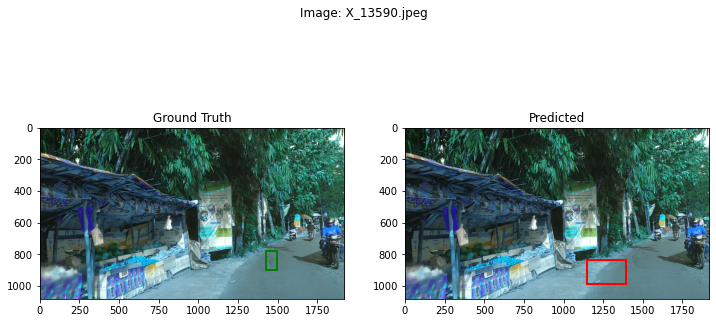

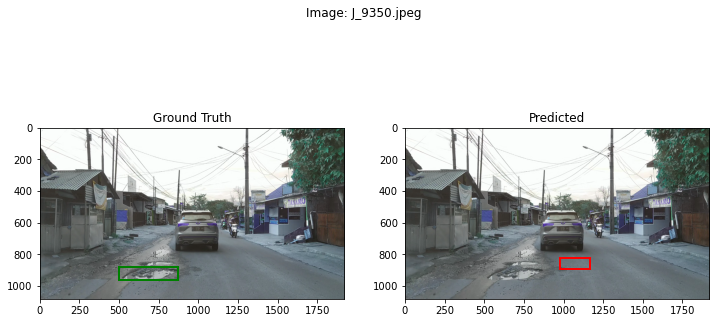

In [ ]:
display_predictions(test_image_dir, test_label_dir, model)

In [16]:
model.save('model.h5')

In [27]:
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import numpy as np

# IoU Calculation
def calculate_iou(box1, box2):
    # Unpack the coordinates
    x1_min, y1_min, x1_max, y1_max = box1
    x2_min, y2_min, x2_max, y2_max = box2
    
    # Calculate intersection
    xi_min = max(x1_min, x2_min)
    yi_min = max(y1_min, y2_min)
    xi_max = min(x1_max, x2_max)
    yi_max = min(y1_max, y2_max)
    inter_width = max(0, xi_max - xi_min)
    inter_height = max(0, yi_max - yi_min)
    intersection_area = inter_width * inter_height
    
    # Calculate union
    box1_area = (x1_max - x1_min) * (y1_max - y1_min)
    box2_area = (x2_max - x2_min) * (y2_max - y2_min)
    union_area = box1_area + box2_area - intersection_area
    
    # Calculate IoU
    iou = intersection_area / union_area
    return iou

# Evaluate model on validation data
val_predictions_class, val_predictions_bbox = model.predict(val_images)

# Convert the class predictions from probabilities to binary (class labels)
val_predictions_class = np.argmax(val_predictions_class, axis=1)

# Assuming val_class_labels contains the true class labels in one-hot encoding format
true_classes = np.argmax(val_class_labels, axis=1)

# Calculate precision, recall, F1-score, and accuracy
precision = precision_score(true_classes, val_predictions_class, average='weighted')
recall = recall_score(true_classes, val_predictions_class, average='weighted')
f1 = f1_score(true_classes, val_predictions_class, average='weighted')
accuracy = accuracy_score(true_classes, val_predictions_class)

# Calculate Mean Squared Error for bounding box predictions (already tracked during training as loss)
mse_bbox_loss = model.evaluate(val_images, val_targets, verbose=0)[2]  # Assuming 'bbox_output' is the second output

# Calculate IoU for the bounding boxes
ious = []
for true_bbox, pred_bbox in zip(val_bbox_labels, val_predictions_bbox):
    iou = calculate_iou(true_bbox, pred_bbox)
    ious.append(iou)

avg_iou = np.mean(ious)

# Print the metrics
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1:.4f}")
print(f"Accuracy: {accuracy:.4f}")
print(f"MSE Bounding Box Loss: {mse_bbox_loss:.4f}")
print(f"Average IoU: {avg_iou:.4f}")


Precision: 0.8390
Recall: 0.8008
F1-Score: 0.8077
Accuracy: 0.8008
MSE Bounding Box Loss: 0.4881
Average IoU: 0.0000
